In [149]:
import pandas as pd
import numpy as np
import os
from sklearn.model_selection import train_test_split
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.decomposition import PCA
import warnings
from pandas.core.common import SettingWithCopyWarning
import plotly.graph_objects as go

In [150]:
def load(file_path):
    data = pd.read_csv(file_path, index_col=0)
    return data

warnings.filterwarnings("ignore", category=RuntimeWarning, message=".*slice*")
warnings.filterwarnings("ignore", category=SettingWithCopyWarning)

## Cleaning cell line expression data and adding resistance labels

#### link:https://depmap.org/portal/download/all/?releasename=DepMap+Public+18Q2&filename=CCLE_DepMap_18Q2_RNAseq_reads_20180502.gct


#### 1. Upload and format

In [152]:
#load the data
cell_lines = 'formatted_cell_lines.csv'
cl_df = pd.read_csv(cell_lines, index_col=0)

#subset to breast
cl_df.index = cl_df.index.str.replace("_BREAST", "")

In [153]:
# Check for remaining missing values using .isnull() (same as .isna())
missing_values = cl_df.isnull().any()

# Print columns with missing values
print("Columns with missing values:")
print(missing_values[missing_values == True])

Columns with missing values:
Series([], dtype: bool)


In [154]:
#make copies
expression = cl_df.copy()
for_test = cl_df.copy()

#### 2. Match indexes and add labels

In [155]:
cell_lines = 'OLA_TERTILE_LN.csv'
sample_sheet = pd.read_csv(cell_lines, index_col=0)

In [157]:
index = sample_sheet.index.intersection(expression.index)
expression_re = expression.loc[index]
sample_sheet_re = sample_sheet.loc[index]

In [158]:
expression_re = expression_re.reindex(sample_sheet_re.index)

In [159]:
expression_re['resistance_label'] = sample_sheet['resistance_label']

#### 3. Split into train and test data

In [160]:
X = expression_re.drop('resistance_label', axis=1)
y = expression_re['resistance_label']

In [161]:
#replace 0.0 with nan so high null counts can be dropped
X.replace(np.nan, 0.0, inplace = True)

In [162]:
pca = PCA(n_components=2)
components = pca.fit_transform(X)

fig = px.scatter(components, x=0, y=1, color=y, #label cols
                 title="PCA of Gene Expression Data (Olaparib Labels)",
                 labels={'0': 'PC1', '1': 'PC2'},
                 color_discrete_map={"less resistance": "blue", "more resistance": "red", "less resistant": "green"},
                 template="plotly",
                 hover_name=X.index,
                 #text=df_copy['batch'],
                 width=450, height=450
                )

fig.update_layout(legend_title_text='Labels', legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1))
fig.show()

In [163]:
rows_to_drop = ['HS578T', 'CAL851', 'HDQP1']
X = X.drop(labels=rows_to_drop)
y = y.drop(labels=rows_to_drop)

In [164]:
pca = PCA(n_components=2)
components = pca.fit_transform(X)

fig = px.scatter(components, x=0, y=1, color=y, #label cols
                 title="Gene Expression PCA after Outlier Removal (Olaparib Labels)",
                 labels={'0': 'PC1', '1': 'PC2'},
                 color_discrete_map={"less resistance": "blue", "more resistance": "red", "less resistant": "green"},
                 template="plotly",
                 hover_name=X.index,
                 #text=df_copy['batch'],
                 width=450, height=450
                )

fig.update_layout(legend_title_text='Labels', legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1))
fig.show()

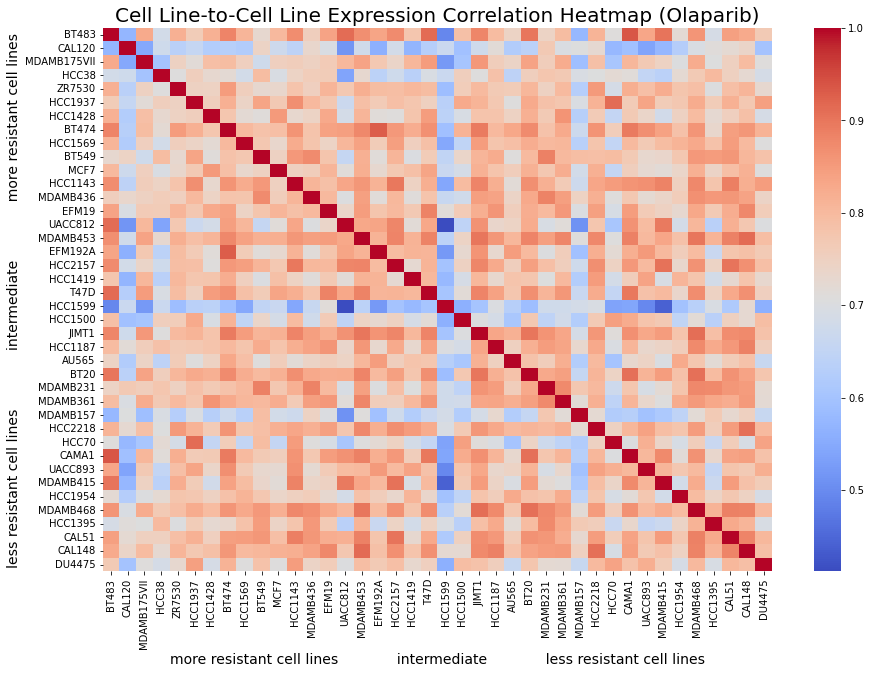

In [165]:
X_T = X.T
correlation_matrix = X_T.corr()

resistance_order = sample_sheet['resistance_label'].unique()
reordered_correlation_matrix = correlation_matrix.reindex(index=resistance_order, columns=resistance_order)

plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=False)
plt.xticks(rotation=90) 
plt.yticks(rotation=0)  
plt.xlabel('more resistant cell lines             intermediate             less resistant cell lines', fontsize=14)
plt.ylabel('less resistant cell lines             intermediate             more resistant cell lines', fontsize=14)
plt.title('Cell Line-to-Cell Line Expression Correlation Heatmap (Olaparib)', fontsize=20)
plt.show()

In [166]:
#replace 0.0 with nan so high null counts can be dropped
X.replace(0.0, np.nan, inplace = True)

In [167]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42, stratify=y)

#### 4. Get IC50(ln) values as labels (if you want to train a different classifier with IC50 values rather than labels)

In [168]:
#make a y_train for ln IC50 values
y_train_IC50 = sample_sheet_re['ln_values']
common_index = y_train_IC50.index.intersection(X_train.index)
y_train_IC50 = y_train_IC50.loc[common_index]

YTIC50 = "Y_TRAIN_IC50_OLA.csv"
y_train_IC50.to_csv(YTIC50, index=True)

In [169]:
#do the same for y_test ln_values
y_test_IC50 = sample_sheet['ln_values']
common_index = y_test_IC50.index.intersection(y_test.index)
y_test_IC50 = y_test_IC50.loc[common_index]

YTSTIC50 = "Y_TEST_IC50_OLA.csv"
y_test_IC50.to_csv(YTSTIC50, index=True)

#### 5. Remove genes with many null counts

In [170]:
def remove_genes_with_null_percentage(dataframe, null_percentage_threshold):
    # Calculate the number of null values for each gene
    total_samples = dataframe.shape[0]
    null_percentages = (dataframe.isna().sum(axis=0) / total_samples) * 100

    # Filter out genes with null counts above the threshold
    genes_to_keep = null_percentages[null_percentages <= null_percentage_threshold].index
    filtered_dataframe = dataframe[genes_to_keep]
    
    removed_genes_count = dataframe.shape[1] - filtered_dataframe.shape[1]

    return filtered_dataframe, removed_genes_count


# Set the null count threshold
null_percentage_threshold = 50  # Modify this value as per your requirement

# Remove genes with many null counts
X_train_filtered, removed_genes_count = remove_genes_with_null_percentage(X_train, null_percentage_threshold)


print(f"Removed {removed_genes_count} genes with >= 50% null count.")

Removed 26408 genes with >= 50% null count.


In [194]:
#replace nan with 0.0 again
X_train_filtered_X = X_train_filtered.fillna(0.0)

In [196]:
outputfile_deseq = "RAW_CLEAN_DESEQ_OLA.csv"
X_train_filtered_X.to_csv(outputfile_deseq, index=True)

#### 6. Percentile rank the training data - to match TCGA data

In [173]:
# Apply percentile ranking
percentiles = X_train_filtered_X.rank(axis=1, pct=True) * 100

# Update the normalized rows back into the original dataframe
X_train_filtered_X.update(percentiles)

#### 7. Unsupervised feature selection - Remove low/zero variance genes

In [174]:
# Set the threshold for the minimum acceptable variance
min_variance_threshold = 0.03

# Calculate the variance for each gene
gene_variances = X_train_filtered_X.var(axis=0)

# Filter out genes with low variance
X_train_var = X_train_filtered_X.loc[:, gene_variances >= min_variance_threshold]

# Display the number of removed genes
removed_genes_count = len(X_train_filtered_X.columns) - len(X_train_var.columns)
print(f"Removed {removed_genes_count} genes with low variance.")

Removed 47 genes with low variance.


#### 8. Check if specific genes have not been filtered

In [175]:
def find_columns_with_string(X_train_var, string):
    matching_columns = [col for col in  X_train_var.columns if string in col]
    return matching_columns

# Set the string to search for in column names
search_string = 'BRCA2' # Modify this value as per your requirement

# Find columns with names containing the specified string
matching_columns = find_columns_with_string(X_train_var, search_string)
matching_columns

['BRCA2']

In [176]:
sample_size = 50
random_sample = X_train_var.sample(n=sample_size, axis=1, random_state=42) 


In [177]:
correlation_matrix_genes = random_sample.corr()
n_top_genes = 100

#### 9. Plot gene-gene correlation with a random sample

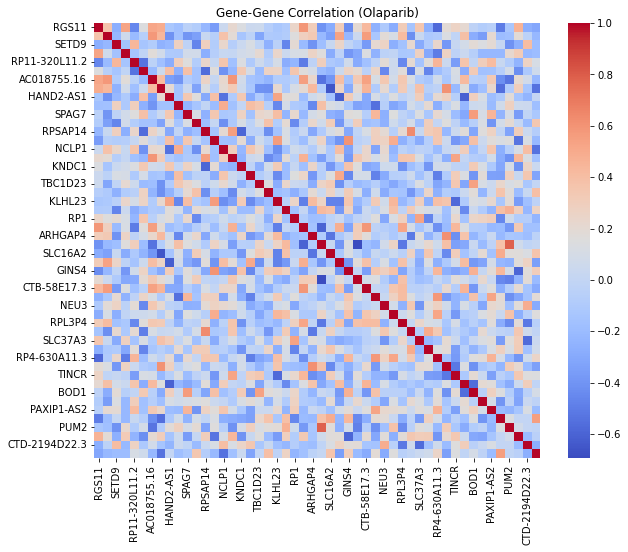

In [178]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix_genes, annot=False, cmap="coolwarm")
plt.title("Gene-Gene Correlation (Olaparib)")
plt.show()

#### 10. Plot average gene expression

In [179]:
df_transposed = X_train_var.T      
group_col = y_train
grouped = X_train_var.groupby(group_col)

box_traces = []
       
for group_name, group_data in grouped:
    box_trace = go.Box(
        y=group_data.T.values,
        name=group_name,
        boxpoints='all',
        jitter=0.3,
        pointpos=-1.8
    )
    box_traces.append(box_trace)

layout = go.Layout(
    title='Box Plot of Average Gene Expression (Olaparib)',
    xaxis=dict(
        title='Cell Line Label'
    ),
    yaxis=dict(
        title='Average Gene Expression',
        nticks=3,
    )
)

fig = go.Figure(data=box_traces, layout=layout)
fig.show()

#### 11. Add labels again

In [180]:
X_train_var['resistance_label'] = X_train_var.index.map(sample_sheet['resistance_label'])

#### 12. Save data and labels

In [181]:
os.chdir('/Users/amyhayward/Documents/BIOINFORMATICS MSC/Project/FINAL_FILES')
outputfile_ola_lbl_ = "X_TRAIN_AH_OLA.csv"
X_train_var.to_csv(outputfile_ola_lbl_, index=True)

In [182]:
lbl = "Y_TRAIN_AH_OLA.csv"
y_train.to_csv(lbl, index=True)

### Test data pre-processing

#### 1. Match features train and test

In [183]:
matched_cols = X_train_var.columns.intersection(X_test.columns)
X_test_match = X_test[matched_cols]
X_test_matched = X_test_match.fillna(0.0)

#### 2. Normalise the test and validation data

In [184]:
percentiles_test = X_test_match.rank(axis=1, pct=True) * 100
X_test_matched.update(percentiles_test)

#### 3. Save test and validation data

In [185]:
# Specify the file path and name for the output .csv file
outputfile_xtest = "X_TEST_AH_OLA.csv"

# Write the DataFrame to a .csv file
X_test_matched.to_csv(outputfile_xtest, index=True)

#### 4. Save test and validation labels

In [186]:
# Specify the file path and name for the output .csv file
outputfile_ytest = "y_TEST_AH_OLA.csv"

# Write the DataFrame to a .csv file
y_test.to_csv(outputfile_ytest, index=True)